# Customer Personality Analysis

## Dataset description from author on Kaggle

Customer Personality Analysis is a detailed analysis of a company’s ideal customers. 
It helps a business to better understand its customers and makes it easier for them 
to modify products according to the specific needs, behaviors, and concerns of 
different types of customers.

Customer personality analysis helps a business to modify its product based on its target customers 
from different types of customer segments. For example, instead of spending money to market a 
new product to every customer in the company’s database, a company can analyze which customer 
segment is most likely to buy the product and then market the product only to that particular segment.

The columns in the dataset include:
- ID: Customer's unique identifier
- Year_Birth: Customer's birth year
- Education: Customer's education level
- Marital_Status: Customer's marital status
- Income: Customer's yearly household income
- Kidhome: Number of children in the customer's household
- Teenhome: Number of teenagers in the customer's household
- Dt_Customer: Date of customer's enrollment with the company
- Recency: Number of days since the customer's last purchase
- Complain: 1 if the customer complained in the last 2 years, 0 otherwise

Products:
- MntWines: Amount spent on wine in the last 2 years
- MntFruits: Amount spent on fruits in the last 2 years
- MntMeatProducts: Amount spent on meat in the last 2 years
- MntFishProducts: Amount spent on fish in the last 2 years
- MntSweetProducts: Amount spent on sweets in the last 2 years
- MntGoldProds: Amount spent on gold in the last 2 years

Promotion:
- NumDealsPurchases: Number of purchases made with a discount
- AcceptedCmp1: 1 if the customer accepted the offer in the 1st campaign, 0 otherwise
- AcceptedCmp2: 1 if the customer accepted the offer in the 2nd campaign, 0 otherwise
- AcceptedCmp3: 1 if the customer accepted the offer in the 3rd campaign, 0 otherwise
- AcceptedCmp4: 1 if the customer accepted the offer in the 4th campaign, 0 otherwise
- AcceptedCmp5: 1 if the customer accepted the offer in the 5th campaign, 0 otherwise
- Response: 1 if the customer accepted the offer in the last campaign, 0 otherwise

Place:
- NumWebPurchases: Number of purchases made through the company's website
- NumCatalogPurchases: Number of purchases made using a catalog
- NumStorePurchases: Number of purchases made directly in stores
- NumWebVisitsMonth: Number of visits to the company's website in the last month
"""


## Importing `libraries` & the `dataset`

In [339]:
# Importing the required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
import os

# Importing specific classes from scikit-learn
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
from sklearn.pipeline import make_pipeline

# Importing datetime modules
from datetime import datetime
from datetime import date

# Read the CSV file into a Pandas DataFrame
df = pd.read_csv("marketing_campaign.csv", sep='\t')

## `DATA CLEANING` & `FEATURE ENGINEERING`


Now, let's dive into the data and understand what steps we should take to clean it up. 
We want to get a full grasp of the information in the dataset. 


- First I quickly inspect the data and get a sense of its structure and content. I also get a list of all the column names present in the dataset.

- I also check out if any of the columns are different from nunmerical datatypes.

In [129]:
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0


In [130]:
df.columns

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response'],
      dtype='object')

- I check if the values in the 'ID' column are unique. There are no duplicate values by the looks of it. 

In [14]:
df.ID.nunique()

# No duplicate values

2240

In [131]:
df.select_dtypes('object')

,Education,Marital_Status,Dt_Customer
0,Graduation,Single,04-09-2012
1,Graduation,Single,08-03-2014
2,Graduation,Together,21-08-2013
3,Graduation,Together,10-02-2014
4,PhD,Married,19-01-2014
...,...,...,...
2235,Graduation,Married,13-06-2013
2236,PhD,Together,10-06-2014
2237,Graduation,Divorced,25-01-2014
2238,Master,Together,24-01-2014


- There are some missing values, as shown by df.info(). The 'Income' column are missing values, and these rows will be dropped.

In [506]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2212 entries, 0 to 2239
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Education            2212 non-null   object 
 1   Income               2212 non-null   float64
 2   Kidhome              2212 non-null   int64  
 3   Teenhome             2212 non-null   int64  
 4   Recency              2212 non-null   int64  
 5   MntWines             2212 non-null   int64  
 6   MntFruits            2212 non-null   int64  
 7   MntMeatProducts      2212 non-null   int64  
 8   MntFishProducts      2212 non-null   int64  
 9   MntSweetProducts     2212 non-null   int64  
 10  MntGoldProds         2212 non-null   int64  
 11  NumDealsPurchases    2212 non-null   int64  
 12  NumWebPurchases      2212 non-null   int64  
 13  NumCatalogPurchases  2212 non-null   int64  
 14  NumStorePurchases    2212 non-null   int64  
 15  NumWebVisitsMonth    2212 non-null   int64 

- After using df.describe() to get a statistical overview of the dataset, I concluded that certain columns have extreme outliers which must be dropped.

In [503]:
df.describe()

,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,AcceptedCmp2,Complain,Response,Age,Customer_Since,Total_Spending,Campaigns_accepted,Household_Size,Clusters_1,Frequency_Purchase
count,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,...,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000,2212.000000
mean,51958.810579,0.441682,0.505877,49.019439,305.287523,26.329566,167.029837,37.648734,27.046564,43.925859,...,0.013562,0.009042,0.150542,54.086347,353.714286,607.268083,0.298373,2.593128,1.618897,14.891501
std,21527.278844,0.536955,0.544253,28.943121,337.322940,39.744052,224.254493,54.772033,41.090991,51.706981,...,0.115691,0.094678,0.357683,11.701599,202.494886,602.513364,0.679570,0.906236,0.989253,7.671629
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,27.000000,0.000000,5.000000,0.000000,1.000000,0.000000,0.000000
25%,35233.500000,0.000000,0.000000,24.000000,24.000000,2.000000,16.000000,3.000000,1.000000,9.000000,...,0.000000,0.000000,0.000000,46.000000,180.000000,69.000000,0.000000,2.000000,1.000000,8.000000
50%,51371.000000,0.000000,0.000000,49.000000,175.500000,8.000000,68.000000,12.000000,8.000000,24.500000,...,0.000000,0.000000,0.000000,53.000000,356.000000,397.000000,0.000000,3.000000,2.000000,15.000000
75%,68487.000000,1.000000,1.000000,74.000000,505.000000,33.000000,232.250000,50.000000,33.000000,56.000000,...,0.000000,0.000000,0.000000,64.000000,529.000000,1048.000000,0.000000,3.000000,2.000000,21.000000
max,162397.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,...,1.000000,1.000000,1.000000,83.000000,699.000000,2525.000000,4.000000,5.000000,3.000000,44.000000


Instead of using date of birth as explanatory column, use this column to calculate their current age.

Instead of using the date a customer started purchasing from the company, calculate the time that has passed

- I calculate the age of each customer by subtracting their birth year from the current year.
- I convert the date of customer enrollment into a proper date format. 
- The number of days in a year is, accounting for leap years and set the current date to a specific value. 
- Finally, I calculate the number of years each customer has been registered with the company by subtracting their enrollment year from the current year. These steps help us gain insights into the age of customers and the duration of their association with the company.

In [137]:
df['Age'] = (2023 - df['Year_Birth'])
df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer'], format='%d-%m-%Y')
days_in_year = 365.2425
date_now = datetime.strptime('May 24 2023', '%b %d %Y')
df['Years_customer'] = (pd.Timestamp('now').year) - (pd.to_datetime(df['Dt_Customer']).dt.year)

The following codeblock will calculate how long each individual has been a customer at the company, in relation to the newest customer.

In [158]:
df["Dt_Customer"] = pd.to_datetime(df["Dt_Customer"])
dates = []
for i in df["Dt_Customer"]:
    i = i.date()
    dates.append(i)  
#Dates of the newest and oldest recorded customer

print("The newest customer's enrolment date in therecords:",max(dates))
print("The oldest customer's enrolment date in the records:",min(dates))

#Created a feature "Customer_For"
days = []
d1 = max(dates) #taking it to be the newest customer
for i in dates:
    delta = d1 - i
    days.append(delta)
df["Customer_Since"] = days
df["Customer_Since"] = pd.to_numeric(df["Customer_Since"], errors="coerce", downcast='integer')
df["Customer_Since"] = df["Customer_Since"]/86400000000000

# This way of calculating duration of being a customer was found in KARNIKA KAPOOR'S solution to this challenge on Kaggle.

#The feature is adjusted to be accurate for the year 2023.

The newest customer's enrolment date in therecords: 2014-06-29
The oldest customer's enrolment date in the records: 2012-07-30


In [161]:
df.Customer_Since.describe()

count    2236.000000
mean      353.773256
std       202.181561
min         0.000000
25%       180.750000
50%       356.000000
75%       529.000000
max       699.000000
Name: Customer_Since, dtype: float64

Series([], Name: Income, dtype: float64)
424     82
1950    83
Name: Age, dtype: int64


Time to remove a couple of outliers.

- An individual with an income of 666666 dollar
- Three people older than 100 years.

In [141]:
df.drop(df[df['Income']>200000].index, inplace=True)

df.drop(df[df['Age']>100].index, inplace=True)

In [ ]:
# Check that they are gone
print(df.loc[df['Income']>200000]['Income'])
print(df.loc[df['Age']>80]['Age'])

It's good to know how much an individual is spending in total, so that their total consumption behaviour can be used in the ML model later. Therefore, I sum total expenditure and call the column 'Total_Spending'

In the same vein, when performing clustering later on, it's good to account for if a person has made use of none, one or several of the campaigns.

In [164]:
df['Total_Spending'] = df['MntWines']+ df['MntFruits']+ df['MntMeatProducts']+ df['MntFishProducts']+ df['MntSweetProducts']+ df['MntGoldProds']

df['Campaigns_accepted'] = df['AcceptedCmp1']+ df['AcceptedCmp2']+ df['AcceptedCmp3']+ df['AcceptedCmp4']+ df['AcceptedCmp5']

In [166]:
df.columns

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response',
       'Age', 'Customer_Since', 'Total_Spending', 'Campaigns_accepted'],
      dtype='object')

A new column called 'Household_Size' is created to represent the size of the customer's household. The household size is determined based on the customer's marital status and the number of teenagers ('Teenhome') and children ('Kidhome') in their household.

By creating this feature, it becomes easier to analyze and segment customers based on the size of their households. It provides insights into customer demographics, such as whether they live alone, with a partner, or with multiple family members. Also, the 'YOLO', 'Alone' and 'Absurd' values are taken care of.

In [170]:
household_size_mapping = ({'Married': 2, 'Together':2, 'Single':1, 'Divorced': 1, 'Widow':1, 'Alone': 1, 'Absurd':1, 'YOLO':1})

df['Household_Size'] = df.Marital_Status.map(household_size_mapping)+df['Teenhome']+df['Kidhome']


The education levels in the dataset are consolidated into broader categories, making it easier to analyze and interpret the data. 

In [184]:
df['Education'] = df['Education'].map({'Graduation':'Masters','PhD':'Doctorate', 'Master':'Masters', 'Basic':'Bachelor', '2n Cycle':'Masters'})

Creating a boolean column for if an individual has used a campaign or not. Visualizing a scatterplot with a hue of two different colors is clearer than with 5 colors.

In [ ]:
df['Has_Used_Campaign'] = df['Campaigns_accepted']>0

In the cells below, null values are dropped (there were only a few missing values in the 'Income' column)

Also, the ID-column is useless for grouping, and Marital_Status, Year_Birth and Dt_Customer columns have already been aggregated into numerical columns or converted to other formats.

Z_CostContact and Z_Revenue provided no value.

In [ ]:
df.dropna(axis=0, inplace=True)
df.drop(columns=(['ID', 'Marital_Status' ,'Year_Birth', 'Z_CostContact', 'Z_Revenue', 'Dt_Customer']),inplace=True)

It's time to make a couple of plots, to get a better overview of the distribution of values in different columns.

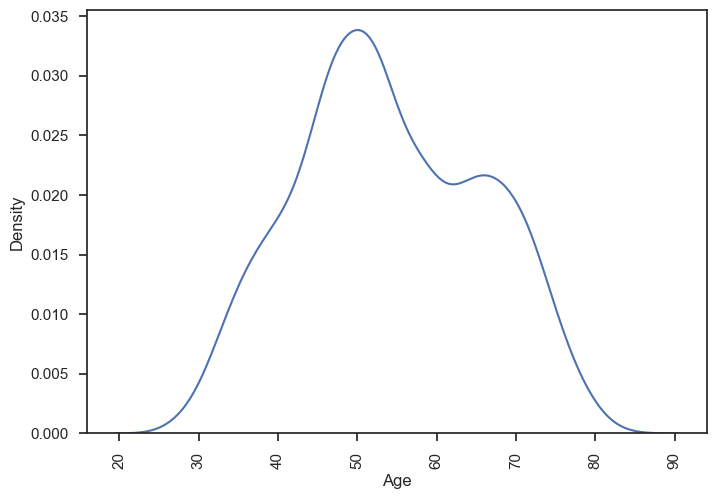

In [188]:
sns.kdeplot(data=df, x='Age')
plt.xticks(rotation=90)

plt.show()

<Axes: xlabel='Household_Size', ylabel='count'>

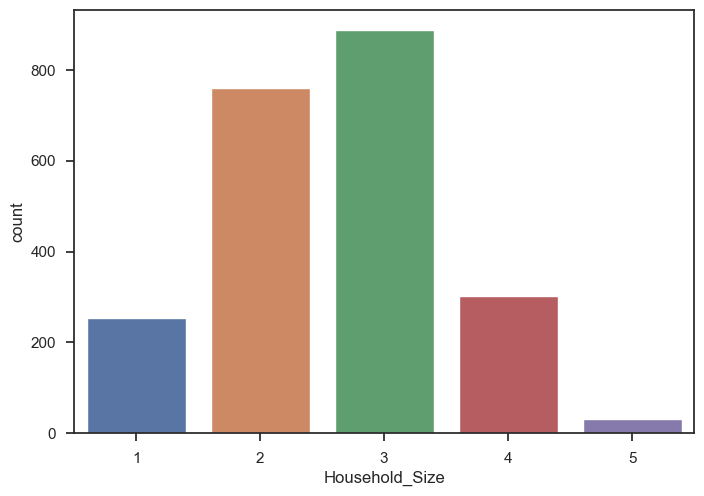

In [189]:
sns.countplot(data=df, x='Household_Size')

<Axes: xlabel='Education', ylabel='count'>

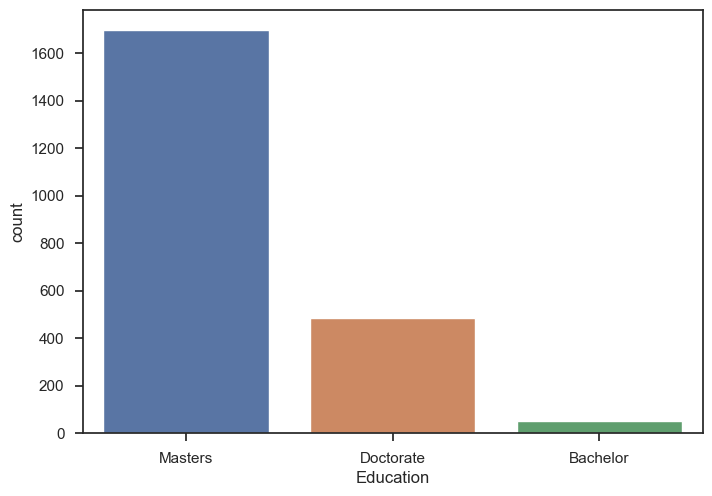

In [190]:
sns.countplot(data=df, x='Education')

In [197]:
df.groupby(by='Education')['Income'].describe()

,count,mean,std,min,25%,50%,75%,max
Education,,,,,,,,
Bachelor,54.0,20306.259259,6235.066773,7500.0,15405.25,20744.0,24882.0,34445.0
Doctorate,480.0,56088.258333,20596.429356,4023.0,40424.25,55185.0,69087.5,162397.0
Masters,1678.0,51796.178188,21246.771473,1730.0,34946.00,51038.0,68731.0,157733.0


In [275]:
# LETS CHECK IF THERE ARE ANY OUTLIERS STILL:

A Pairplot of selected features


<Figure size 640x440 with 0 Axes>

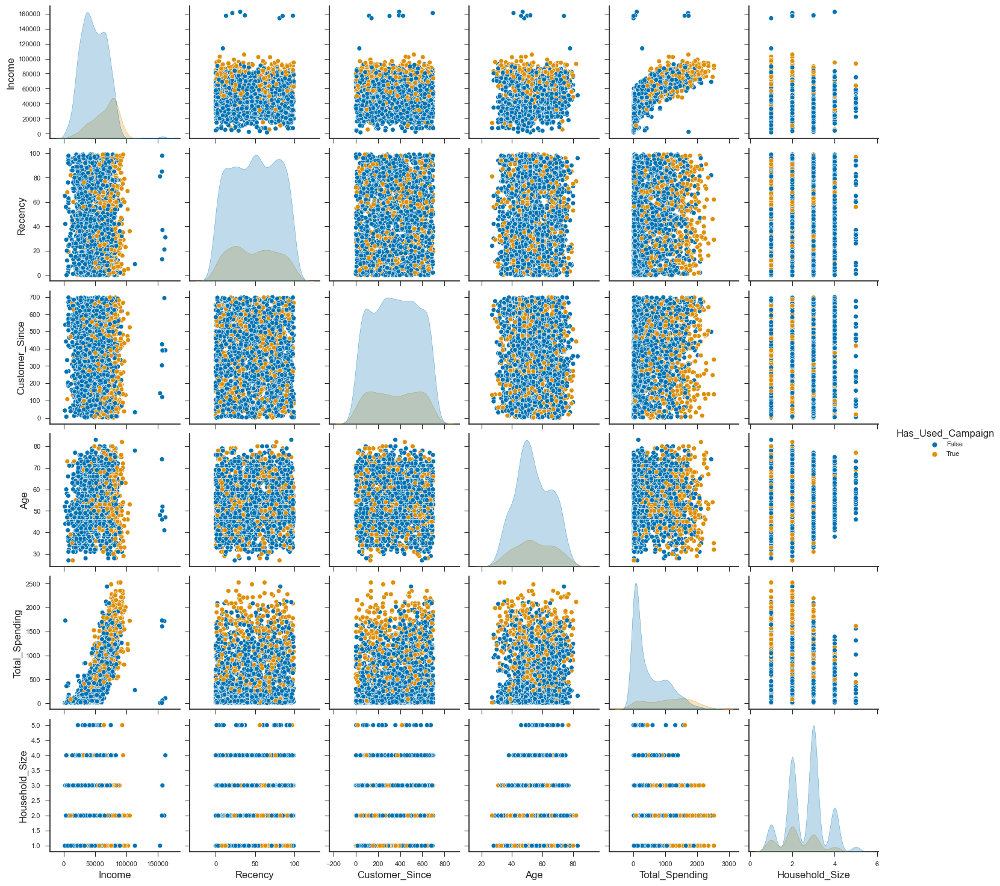

There are a couple of individuals with a lot higher salary than the rest. But it doesn't fall outside the realm of possibility.

Let's make a correlation matrix with the seaborn heatmap.

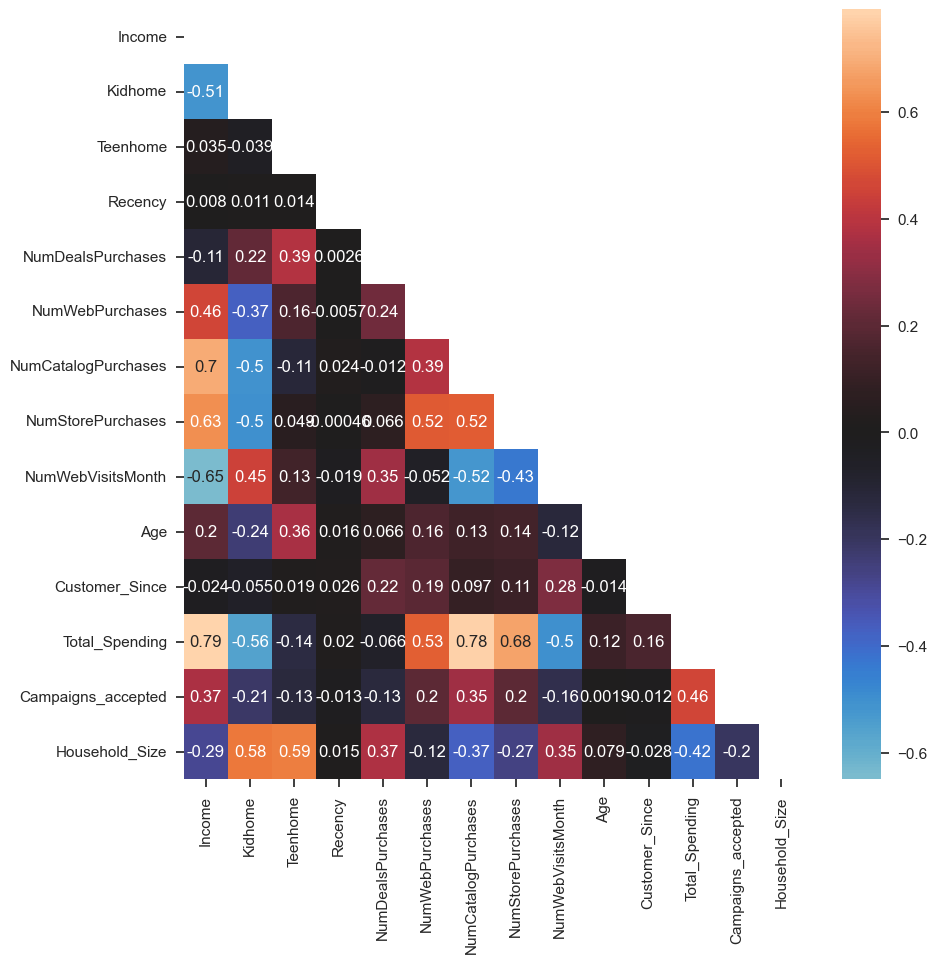

In [512]:
# Variables to include in the correlation matrix
corrmatrix_var = ['Income', 'Kidhome', 'Teenhome', 'Recency', 'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth', 'Age', 'Customer_Since', 'Total_Spending', 'Campaigns_accepted', 'Household_Size']

# Correlation matrix for the selected variables
corrmatrix = df[corrmatrix_var].corr()

# Create a mask to remove the top half of the heatmap
mask = np.triu(np.ones_like(corrmatrix, dtype=bool))

# Set up the figure size
plt.figure(figsize=(10, 10))

# Plot the heatmap with the updated mask
sns.heatmap(corrmatrix, annot=True, center=0, mask=mask)

# Display the plot
plt.show()

Some quick notes here are that income correlates highly with multiple other variables. 

In [231]:
plt.style.available

['Solarize_Light2',
 '_classic_test_patch',
 '_mpl-gallery',
 '_mpl-gallery-nogrid',
 'bmh',
 'classic',
 'dark_background',
 'fast',
 'fivethirtyeight',
 'ggplot',
 'grayscale',
 'seaborn-v0_8',
 'seaborn-v0_8-bright',
 'seaborn-v0_8-colorblind',
 'seaborn-v0_8-dark',
 'seaborn-v0_8-dark-palette',
 'seaborn-v0_8-darkgrid',
 'seaborn-v0_8-deep',
 'seaborn-v0_8-muted',
 'seaborn-v0_8-notebook',
 'seaborn-v0_8-paper',
 'seaborn-v0_8-pastel',
 'seaborn-v0_8-poster',
 'seaborn-v0_8-talk',
 'seaborn-v0_8-ticks',
 'seaborn-v0_8-white',
 'seaborn-v0_8-whitegrid',
 'tableau-colorblind10']

In [232]:
plt.style.use('seaborn-v0_8-paper')
sns.set_palette(palette='colorblind')

## Data `preprocessing` and *`clustering`*

- Categorical features are labeled with numbers for better understanding.
- Features are scaled using a standard scaler for consistency.
- Categorical variables are converted into numerical format.

In [ ]:
df_scaled = df.copy()

In [ ]:
df_scaled.head()

In [310]:
df_scaled.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2212 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Education            2212 non-null   object 
 1   Income               2212 non-null   float64
 2   Kidhome              2212 non-null   int64  
 3   Teenhome             2212 non-null   int64  
 4   Recency              2212 non-null   int64  
 5   MntWines             2212 non-null   int64  
 6   MntFruits            2212 non-null   int64  
 7   MntMeatProducts      2212 non-null   int64  
 8   MntFishProducts      2212 non-null   int64  
 9   MntSweetProducts     2212 non-null   int64  
 10  MntGoldProds         2212 non-null   int64  
 11  NumDealsPurchases    2212 non-null   int64  
 12  NumWebPurchases      2212 non-null   int64  
 13  NumCatalogPurchases  2212 non-null   int64  
 14  NumStorePurchases    2212 non-null   int64  
 15  NumWebVisitsMonth    2212 non-null   int64 

In [311]:
df_scaled.Education.unique()

array(['Masters', 'Doctorate', 'Bachelor'], dtype=object)

In [312]:
education_mapper = {'Bachelor':1, 'Masters':2, 'Doctorate':3}

df_scaled['Education'] = df_scaled['Education'].map(education_mapper)

Here, I use the KElbowVisualizer to confirm the recommended amount of clusters for this dataset, and fit it onto the scaled date.

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('kelbowvisualizer',
                 KElbowVisualizer(ax=<Axes: >,
                                  estimator=KMeans(n_clusters=10)))])

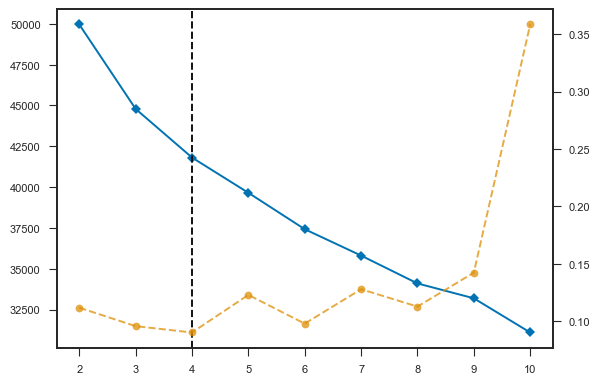

In [313]:
scaler = StandardScaler()
cluster = KElbowVisualizer(KMeans())
pipe = make_pipeline(scaler, cluster)

pipe.fit(df_scaled)

This code block aims to determine the optimal number of clusters for a dataset using the K-means clustering algorithm. It iterates over a range of cluster numbers, applies scaling to the data, performs clustering, and calculates the inertia value for each cluster number. The inertia values, representing the coherence of the clusters, are collected and visualized in a line plot. The plot helps identify the elbow point, indicating the recommended number of clusters where the inertia starts to level off or decrease significantly.

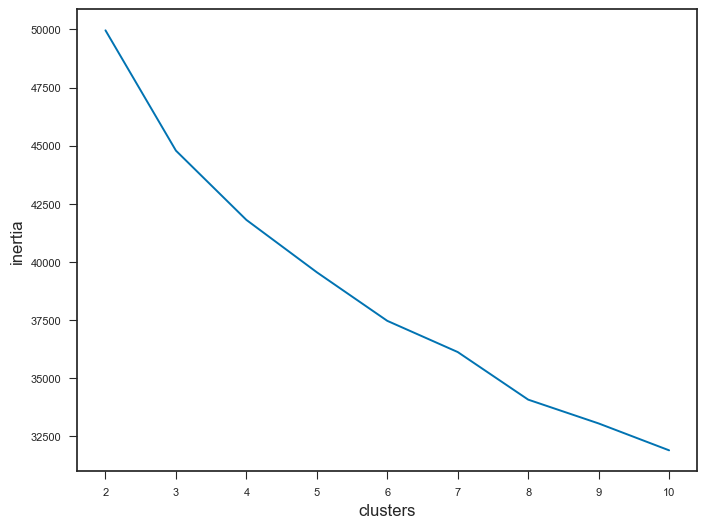

In [314]:
# first we have to get the inertia values for a variety of different cluster numbers
inertia_dict = {
    'clusters': []
    ,'inertia': []
}

for i in range(2,11): # we choose 2 as the minimum number of clusters. it doesnt really make sense to have 1 cluster
    scaler = StandardScaler()
    cluster = KMeans(n_clusters=i) # here we set the number of clusters for every iteration
    pipe = make_pipeline(scaler, cluster)
    pipe.fit(df_scaled)
    inertia_dict['clusters'].append(i)
    inertia_dict['inertia'].append(pipe['kmeans'].inertia_)

inertia_df = pd.DataFrame(inertia_dict)

plt.figure(figsize=(8, 6))
g = sns.lineplot(data=inertia_df, x='clusters', y='inertia')
plt.show()

This codeblock performs the clustering on the scaled dataset, and applies the four cluster labels onto the original dataframe

In [315]:
scaler = StandardScaler()
cluster = KMeans(n_clusters=4)
pipe = make_pipeline(scaler, cluster)

pipe.fit(df_scaled)

df['clusters'] = pipe['kmeans'].labels_

df

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('kmeans', KMeans(n_clusters=4))])

## Evauluating the model and plotting insights

When creating the pairplot after finishing all the clusters, it allows for cluster validation and interpretation, feature comparison, and potential refinement of the clustering results. It helps in assessing the quality of the clusters and gaining insights into the relationships between the features and the clusters.

A Pairplot of selected features


<Figure size 640x440 with 0 Axes>

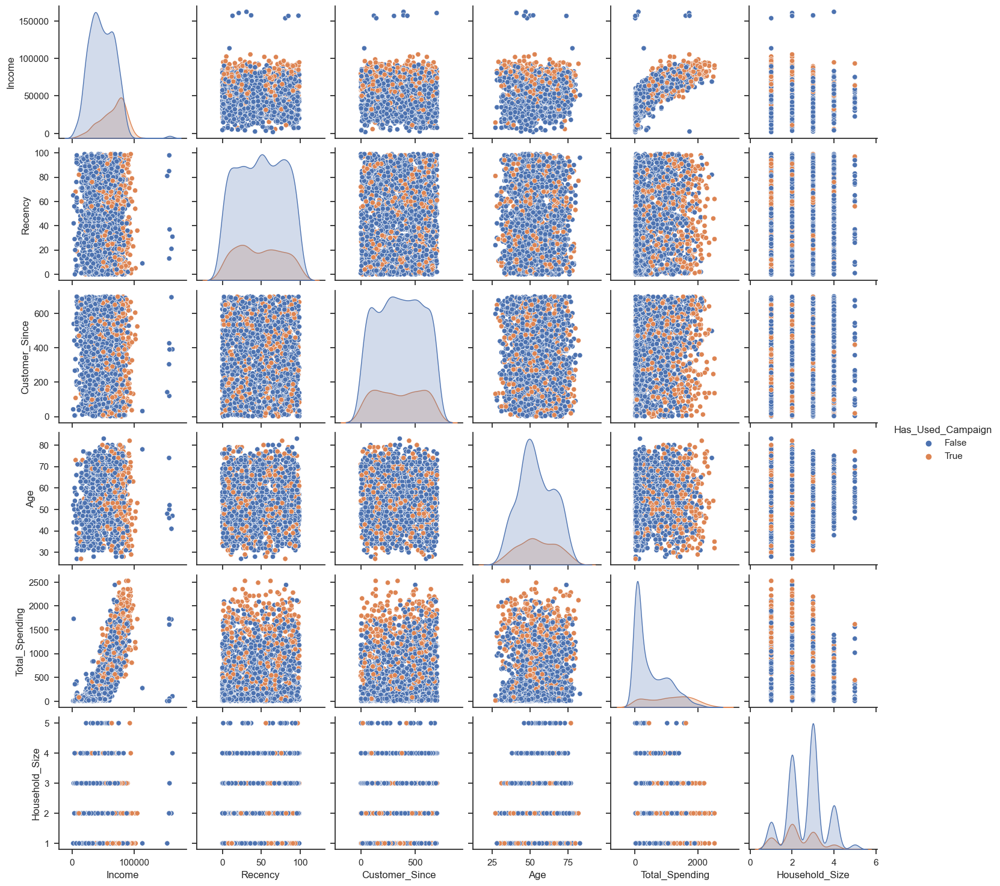

In [513]:
#Plotting following features
To_Plot = [ "Income", "Recency", "Customer_Since", "Age", "Total_Spending", "Household_Size", 'Has_Used_Campaign']
print("A Pairplot of selected features")
plt.figure()
sns.pairplot(df[To_Plot], hue= 'Has_Used_Campaign')
#Taking hue 
plt.show()

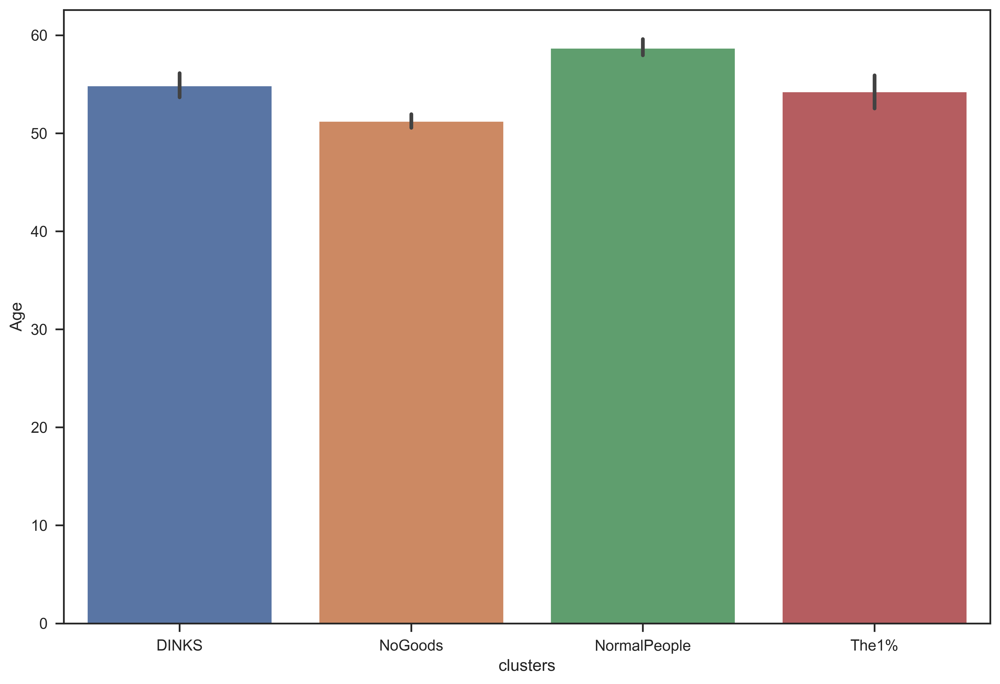

In [470]:
plt.figure(figsize=(12,8), dpi=500)
sns.barplot(data=df, x='clusters', y='Age')
plt.show()

In [457]:
cluster_mapper = {0:'NoGoods', 1: 'NormalPeople', 2:'DINKS', 3:'The1%'}

df['clusters'] = df['clusters'].map(cluster_mapper)

In [514]:
import math
var_list = ['Education', 'Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines',
       'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response', 'Age', 'Customer_Since',
       'Total_Spending', 'Campaigns_accepted', 'Household_Size',
       'Has_Used_Campaign']

cols = 2
rows = math.ceil(len(var_list)/cols)

fig, axs = plt.subplots(nrows=rows, ncols=cols, figsize=(20,5*rows), dpi=500)

for i, ax in zip(var_list, axs.flat):
    g = sns.barplot(data=df, x='clusters', y=i, ax=ax)
    ax.set(xlabel='', ylabel='', title=i)

for i in axs.flat[::-1][:rows*cols-len(var_list)]:
    i.set_axis_off()

plt.show()

TypeError: Neither the `x` nor `y` variable appears to be numeric.

In [409]:
cluster0_education_subset = pd.DataFrame(df.loc[df['clusters']==0]['Education'])
cluster1_education_subset = pd.DataFrame(df.loc[df['clusters']==1]['Education'])
cluster2_education_subset = pd.DataFrame(df.loc[df['clusters']==2]['Education'])
cluster3_education_subset = pd.DataFrame(df.loc[df['clusters']==3]['Education'])

In [421]:
cluster0_education_subset = cluster0_education_subset.groupby(by='Education').count()
cluster1_education_subset = cluster1_education_subset.groupby(by='Education').count()
cluster2_education_subset = cluster2_education_subset.groupby(by='Education').count()
cluster3_education_subset = cluster3_education_subset.groupby(by='Education').count()

In [426]:
cluster1_education_subset.reset_index(inplace=True)
cluster0_education_subset.reset_index(inplace=True)
cluster2_education_subset.reset_index(inplace=True)
cluster3_education_subset.reset_index(inplace=True)

In [413]:
cluster0_education_subset['cluster'] = 0
cluster1_education_subset['cluster'] = 1
cluster2_education_subset['cluster'] = 2
cluster3_education_subset['cluster'] = 3

In [435]:
print(cluster0_education_subset)
print(cluster1_education_subset)
print(cluster2_education_subset)
print(cluster3_education_subset)

   Education  cluster
0   Bachelor       52
1  Doctorate      186
2    Masters      785
   Education  cluster
0   Bachelor        1
1  Doctorate      159
2    Masters      386
   Education  cluster
0   Bachelor        1
1  Doctorate       81
2    Masters      318
   Education  cluster
0  Doctorate       54
1    Masters      189


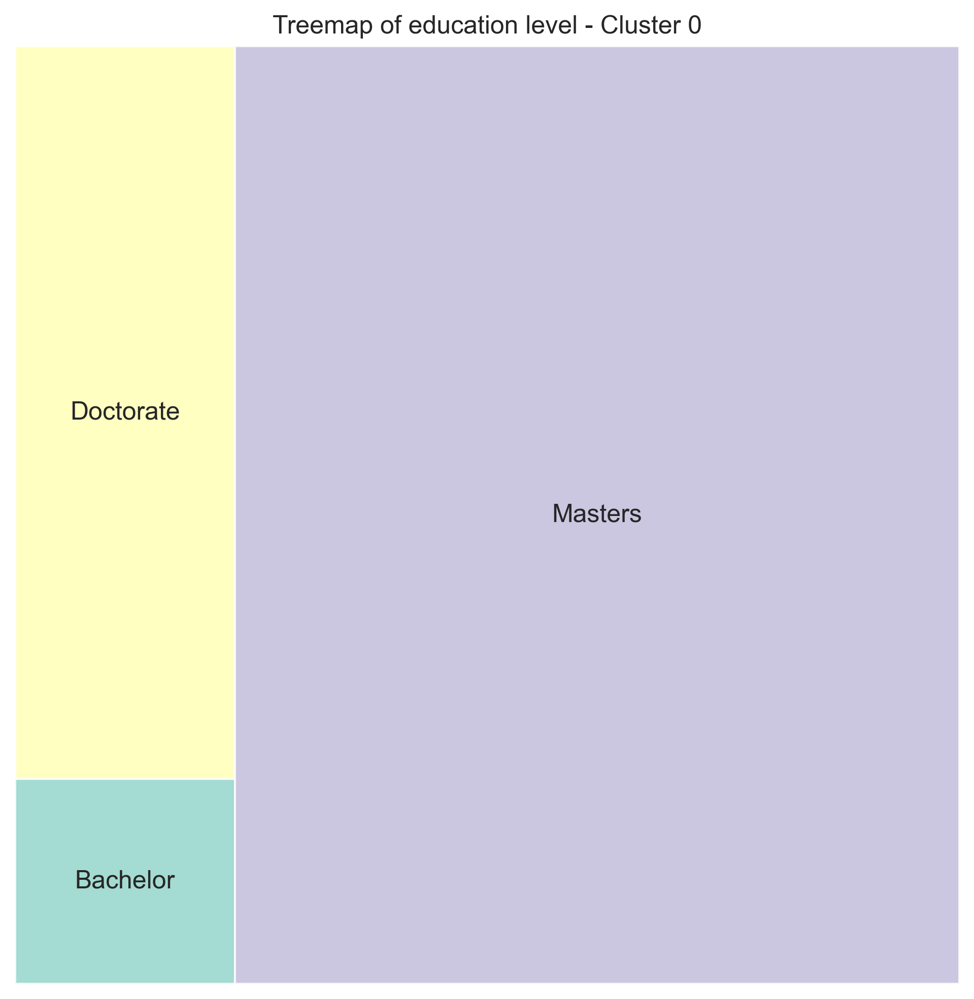

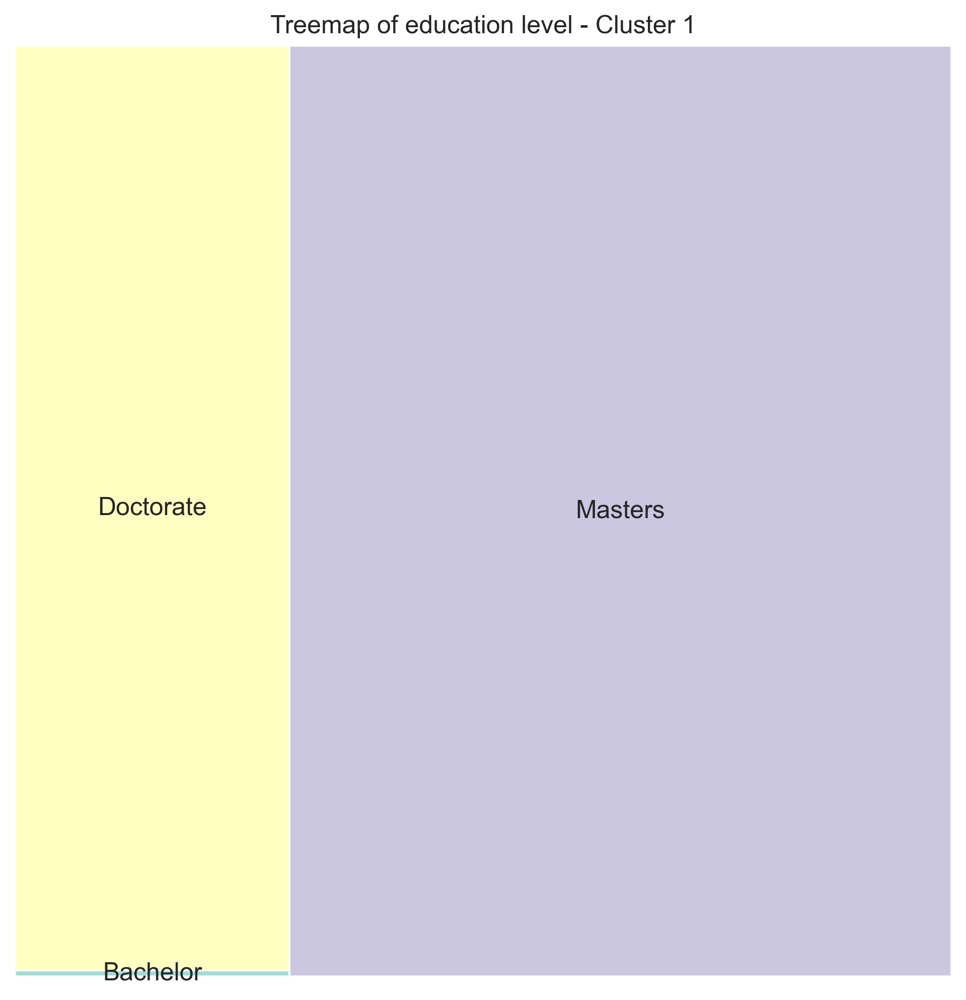

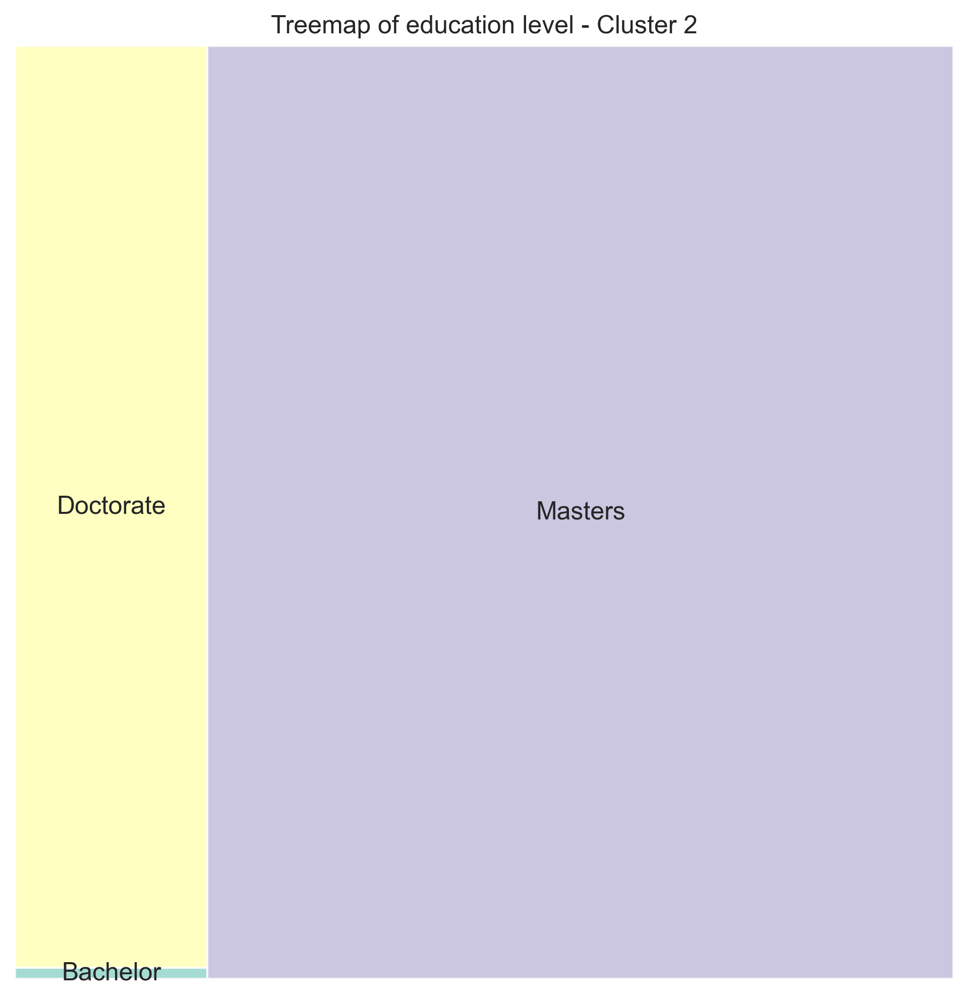

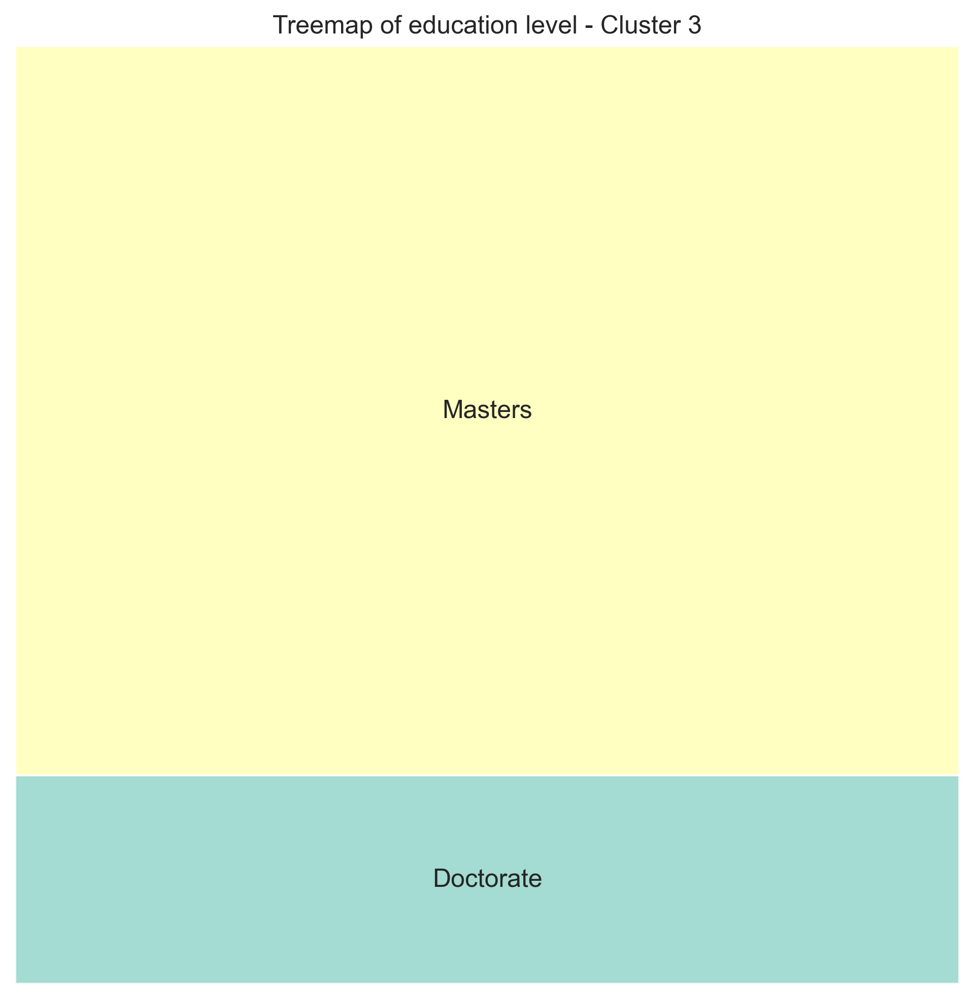

In [443]:
# Define a common color palette
color_palette = plt.cm.Set3(range(3))

# Plot and save each treemap separately
plt.figure(figsize=(8, 8), dpi=300)
plt.title('Treemap of education level - NoGoods')
squarify.plot(sizes=cluster0_education_subset['cluster'], label=cluster0_education_subset['Education'], color=color_palette, alpha=0.8)
plt.axis('off')
plt.savefig('treemap_cluster0.png', dpi=300)

plt.figure(figsize=(8, 8), dpi=300)
plt.title('Treemap of education level - Cluster 1')
squarify.plot(sizes=cluster1_education_subset['cluster'], label=cluster1_education_subset['Education'], color=color_palette, alpha=0.8)
plt.axis('off')
plt.savefig('treemap_cluster1.png', dpi=300)

plt.figure(figsize=(8, 8), dpi=300)
plt.title('Treemap of education level - Cluster 2')
squarify.plot(sizes=cluster2_education_subset['cluster'], label=cluster2_education_subset['Education'], color=color_palette, alpha=0.8)
plt.axis('off')
plt.savefig('treemap_cluster2.png', dpi=300)

plt.figure(figsize=(8, 8), dpi=300)
plt.title('Treemap of education level - Cluster 3')
squarify.plot(sizes=cluster3_education_subset['cluster'], label=cluster3_education_subset['Education'], color=color_palette, alpha=0.8)
plt.axis('off')
plt.savefig('treemap_cluster3.png', dpi=300)

plt.show()

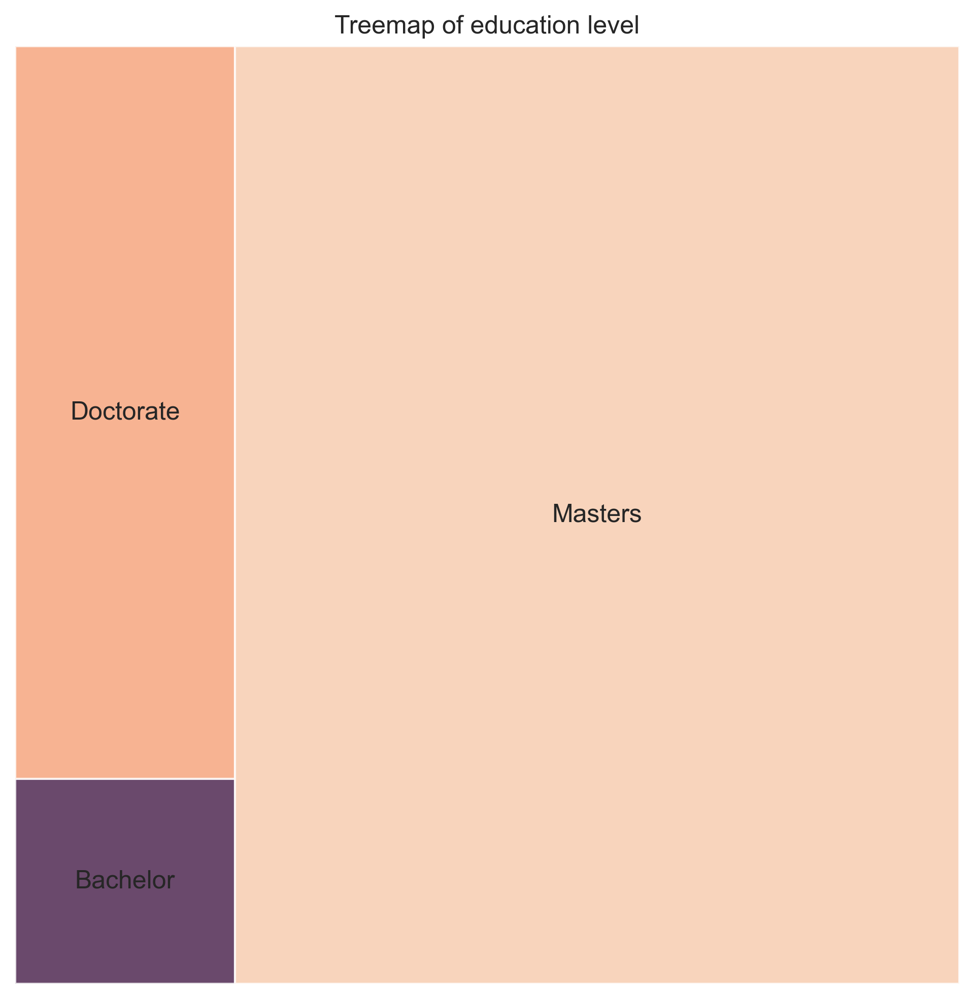

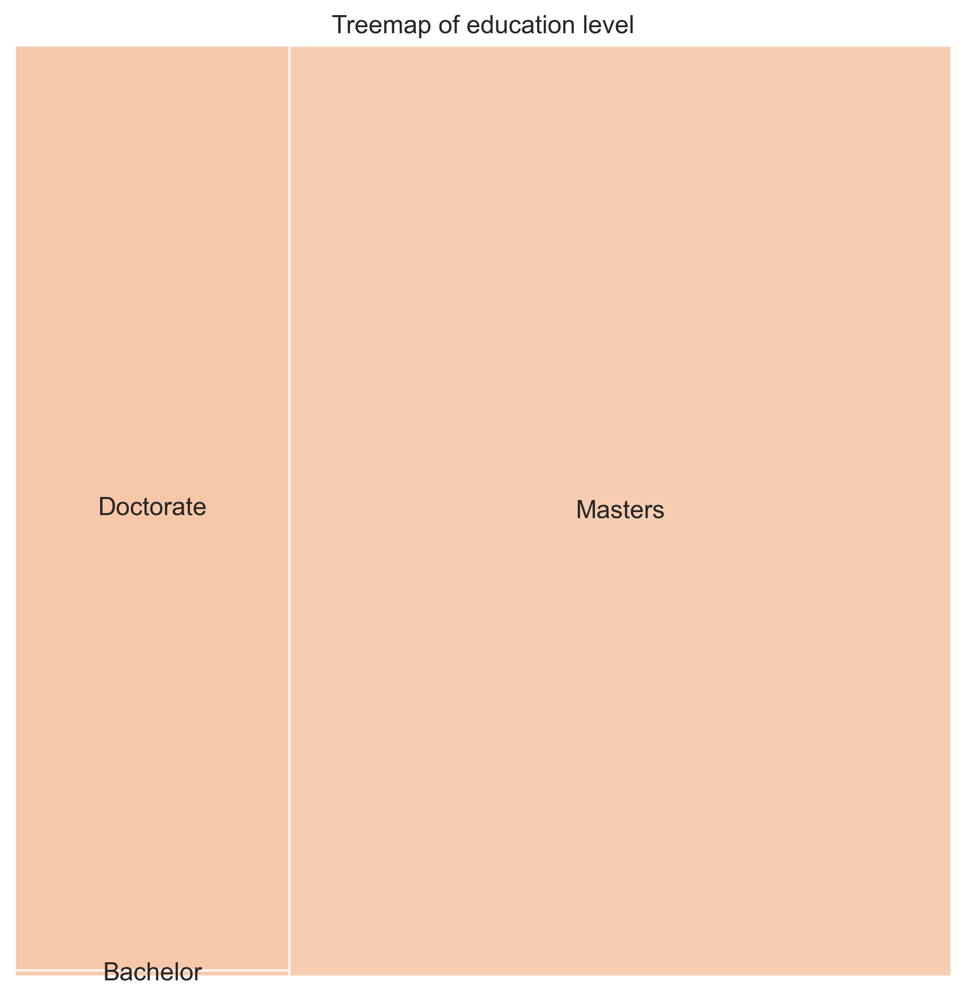

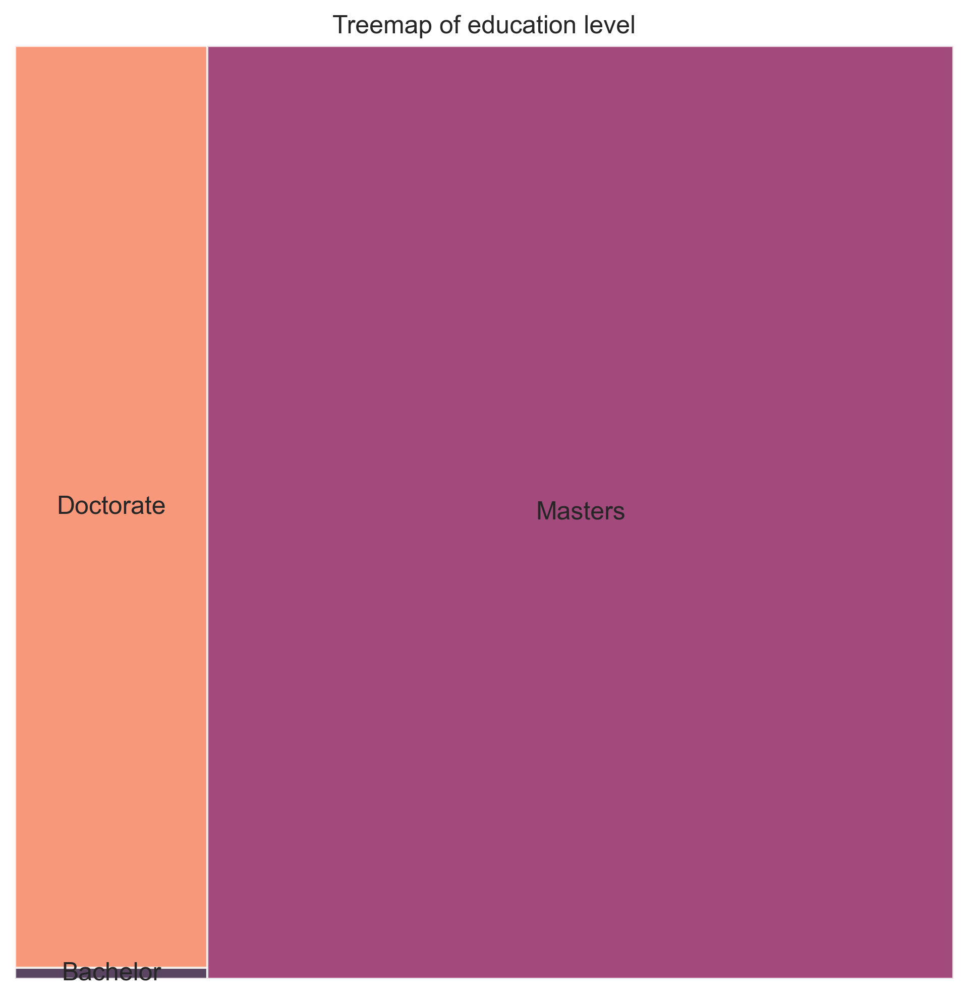

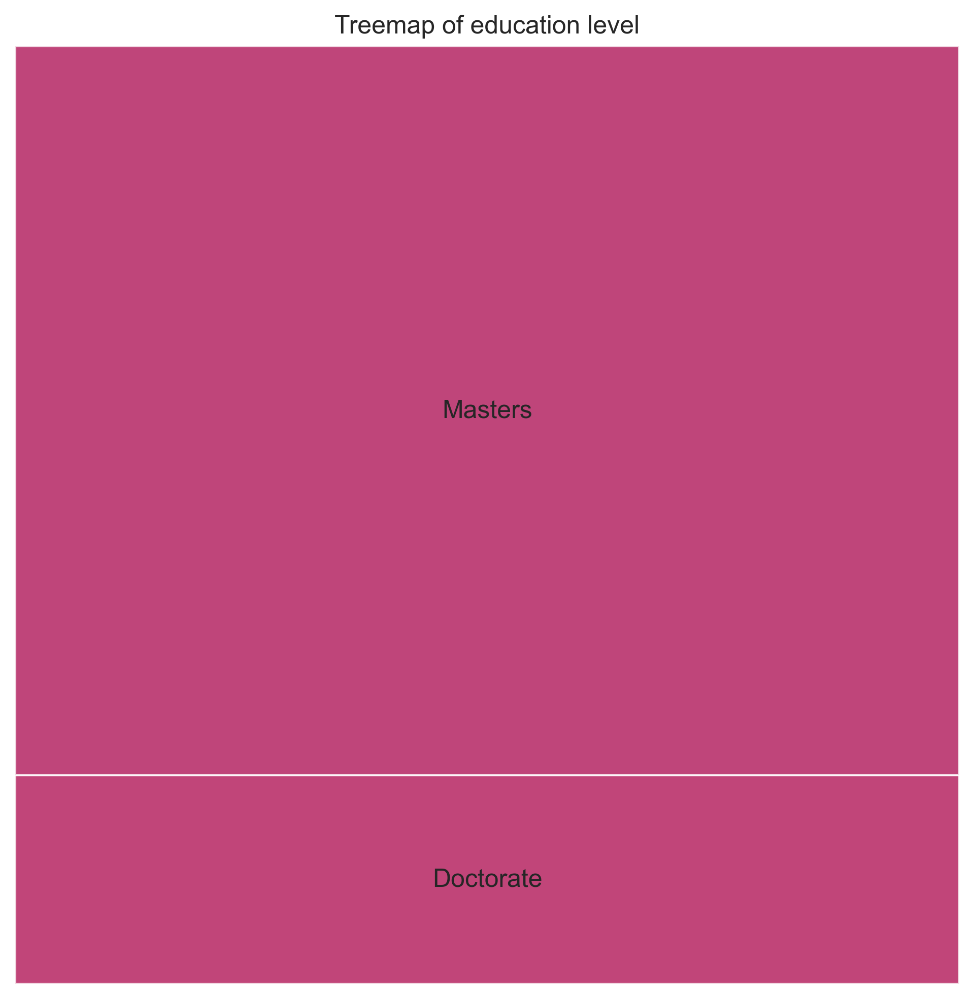

In [442]:
# plot it
plt.figure(figsize=(8,8), dpi=300)
plt.title(loc='center', label='Treemap of education level')
squarify.plot(sizes=cluster0_education_subset['cluster'], label=cluster0_education_subset['Education'], alpha=.8)
plt.axis('off')
plt.show()

plt.figure(figsize=(8,8), dpi=300)
plt.title(loc='center', label='Treemap of education level')
squarify.plot(sizes=cluster1_education_subset['cluster'], label=cluster1_education_subset['Education'], alpha=.8)
plt.axis('off')
plt.show()

plt.figure(figsize=(8,8), dpi=300)
plt.title(loc='center', label='Treemap of education level')
squarify.plot(sizes=cluster2_education_subset['cluster'], label=cluster2_education_subset['Education'], alpha=.8)
plt.axis('off')
plt.show()

plt.figure(figsize=(8,8), dpi=300)
plt.title(loc='center', label='Treemap of education level')
squarify.plot(sizes=cluster3_education_subset['cluster'], label=cluster3_education_subset['Education'], alpha=.8)
plt.axis('off')
plt.show()

<Axes: xlabel='clusters', ylabel='count'>

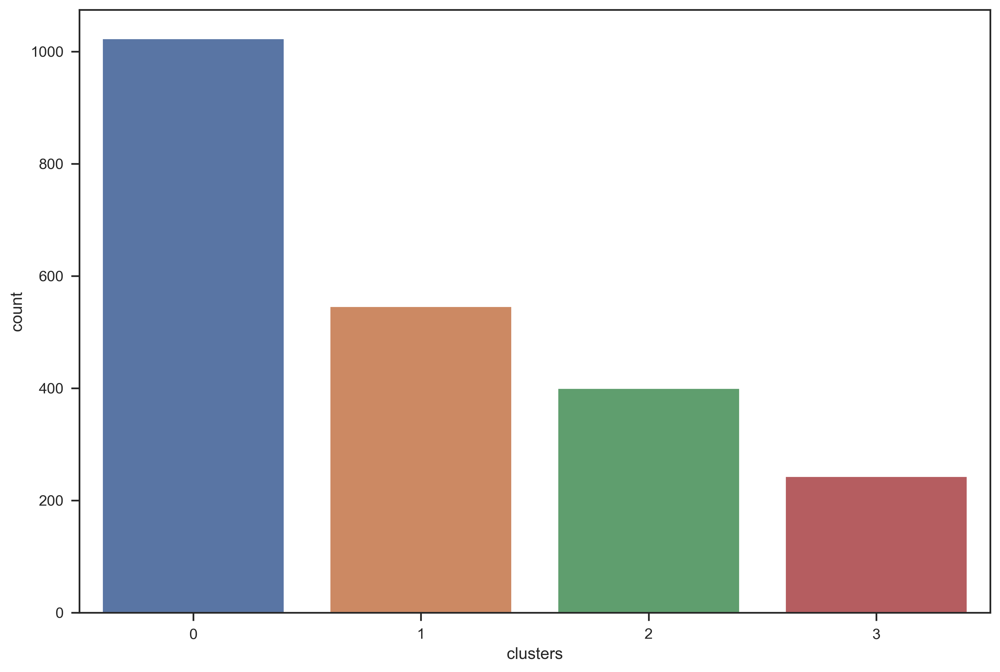

In [348]:
plt.figure(figsize=(12,8), dpi=300)
sns.countplot(data=df, x='clusters')

<Axes: xlabel='clusters', ylabel='Income'>

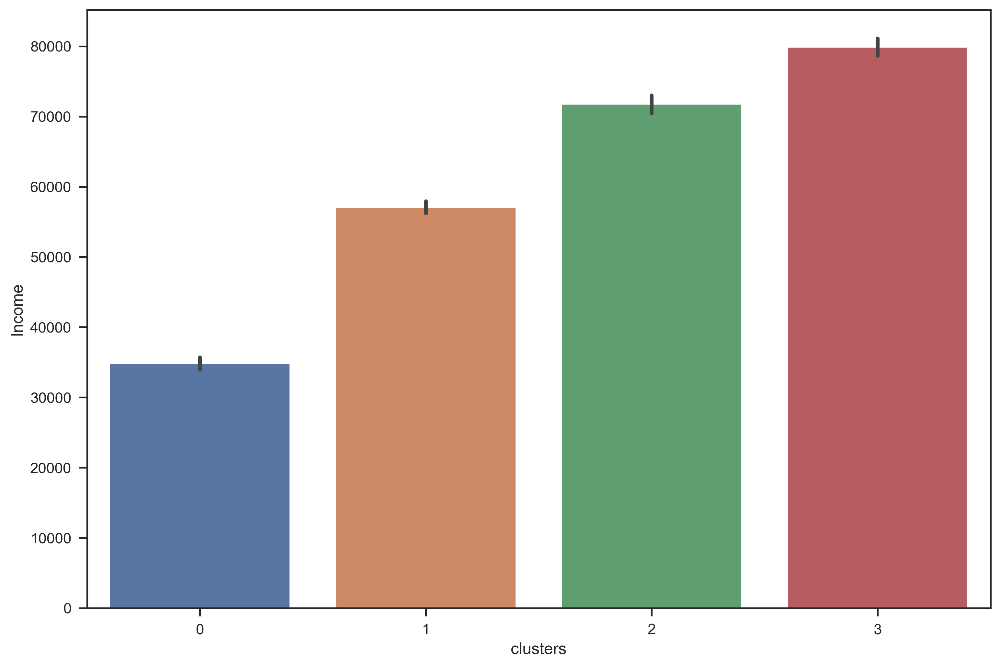

In [434]:
plt.figure(figsize=(12,8), dpi=300)
sns.barplot(data=df, x='clusters', y='Income')

In [447]:
cluster0_education_subset

,Education,cluster
0,Bachelor,52
1,Doctorate,186
2,Masters,785


posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


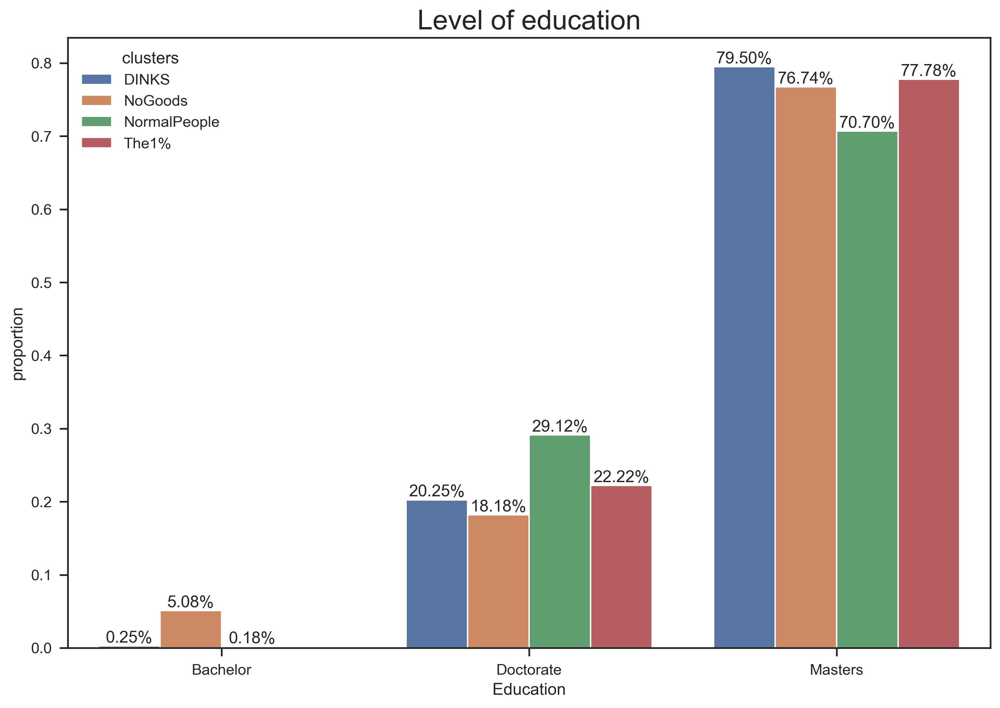

In [475]:
plt.figure(figsize=(12, 8), dpi=300)

# Calculate proportions
total_counts = df.groupby('clusters')['Education'].count()
normalized_counts = df.groupby(['clusters', 'Education']).size().div(total_counts, level='clusters').reset_index(name='proportion')

# Plot the countplot with proportions
ax = sns.barplot(data=normalized_counts, x='Education', y='proportion', hue='clusters')
plt.title(label='Level of education', fontsize=20)

# Add text annotations
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x() + p.get_width() / 2, height, f'{height:.2%}', ha='center', va='bottom')

plt.savefig(transparent=True, fname='LevleofEducation')
plt.show()


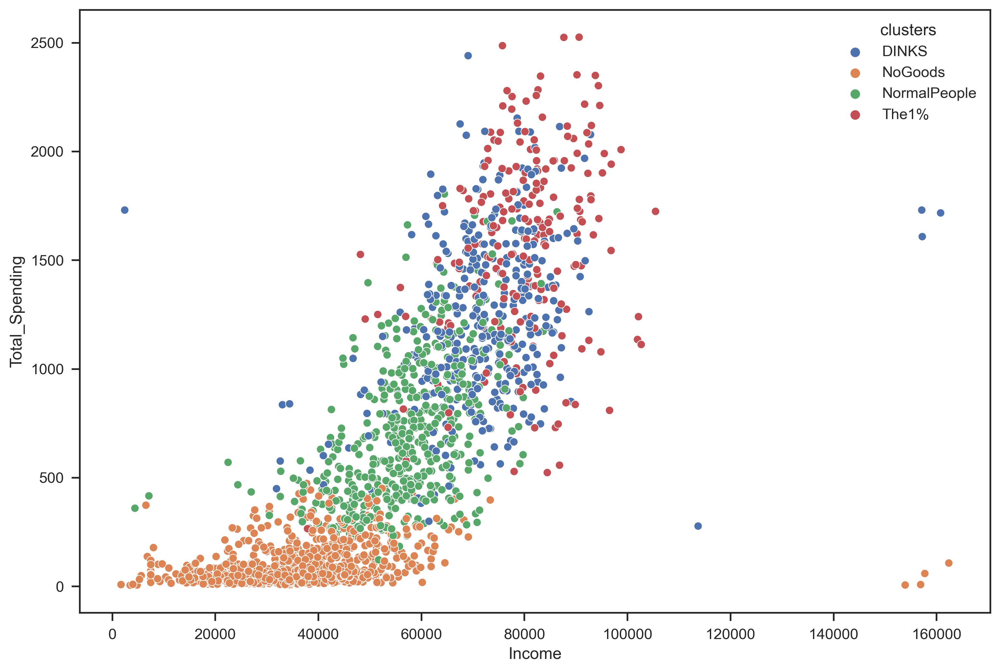

In [459]:
plt.figure(figsize=(12,8), dpi=300)
sns.scatterplot(data=df, y='Total_Spending', x='Income', hue='clusters')
plt.show()

In [454]:
df.columns

Index(['Education', 'Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines',
       'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response', 'Age', 'Customer_Since',
       'Total_Spending', 'Campaigns_accepted', 'Household_Size',
       'Has_Used_Campaign', 'clusters', 'Clusters_1'],
      dtype='object')

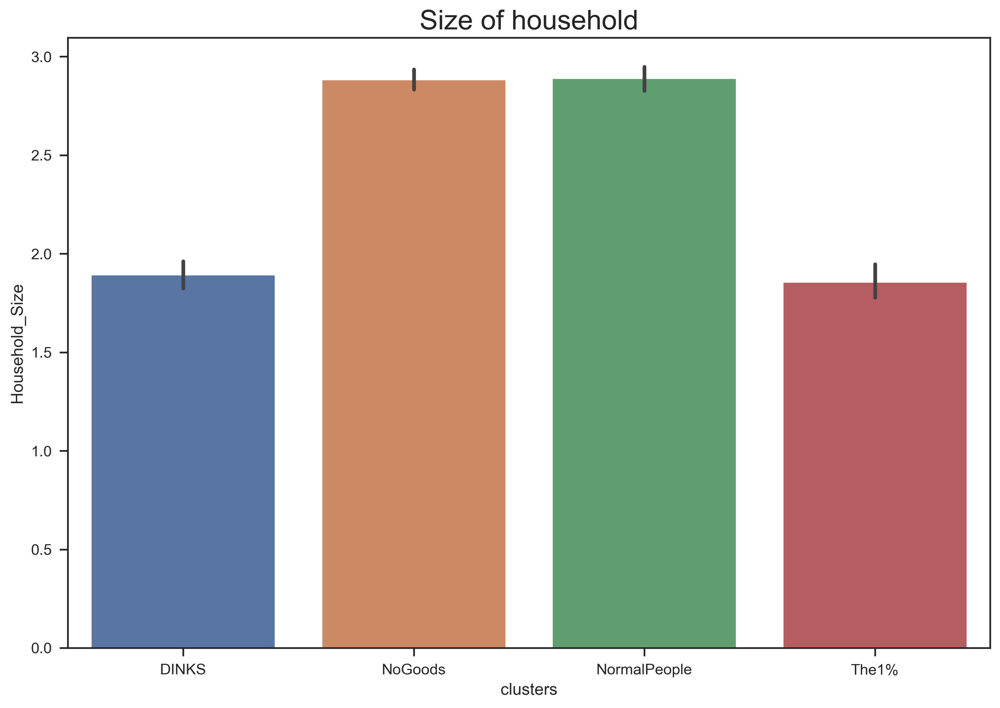

In [474]:
plt.figure(figsize=(12,8), dpi=300)
sns.barplot(data=df, x='clusters', y='Household_Size')
plt.title(label='Size of household', fontsize=20)
plt.savefig(transparent=True, fname='SizeofHousehold')

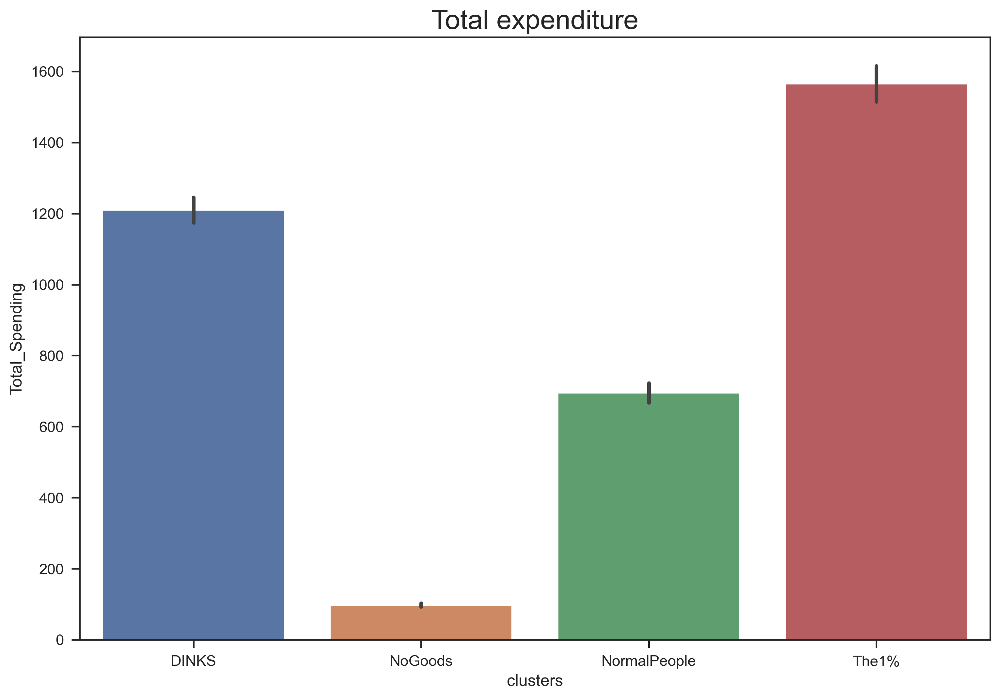

In [476]:
plt.figure(figsize=(12,8), dpi=300)
sns.barplot(data=df, x='clusters', y='Total_Spending')
plt.title(label='Total expenditure', fontsize=20)
plt.savefig(transparent=True, fname='Expenditure_cluster')

In [479]:
df['Frequency_Purchase'] = df['NumDealsPurchases']+ df['NumWebPurchases']+df['NumCatalogPurchases']+ df['NumStorePurchases']

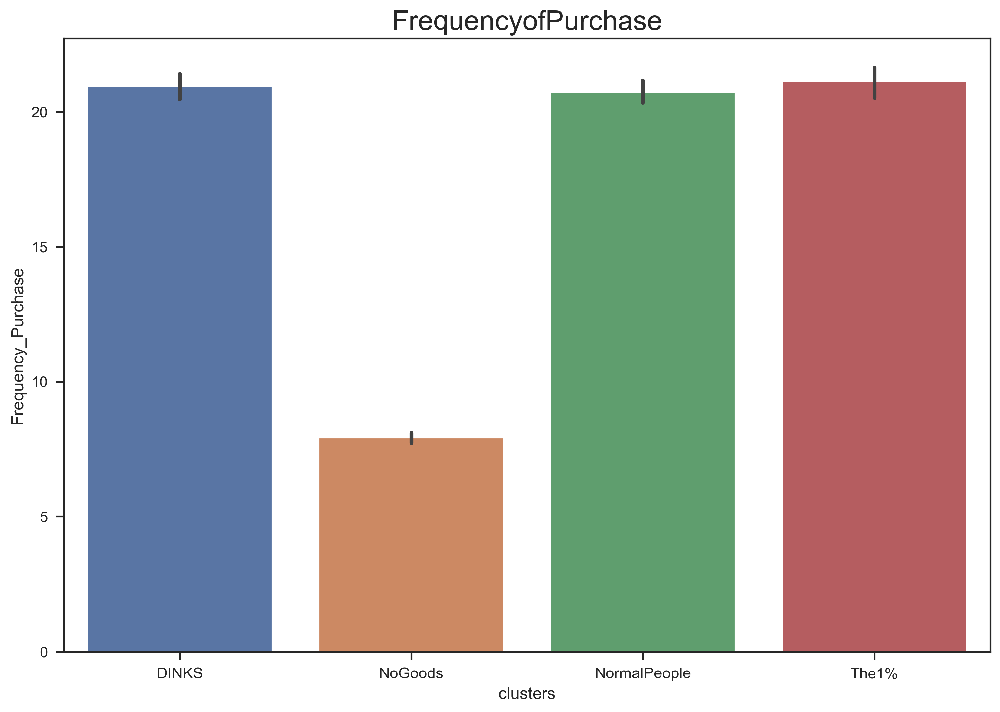

In [480]:
plt.figure(figsize=(12,8), dpi=300)
sns.barplot(data=df, x='clusters', y='Frequency_Purchase')
plt.title(label='FrequencyofPurchase', fontsize=20)
plt.savefig(transparent=True, fname='FrequencyofPurchase')

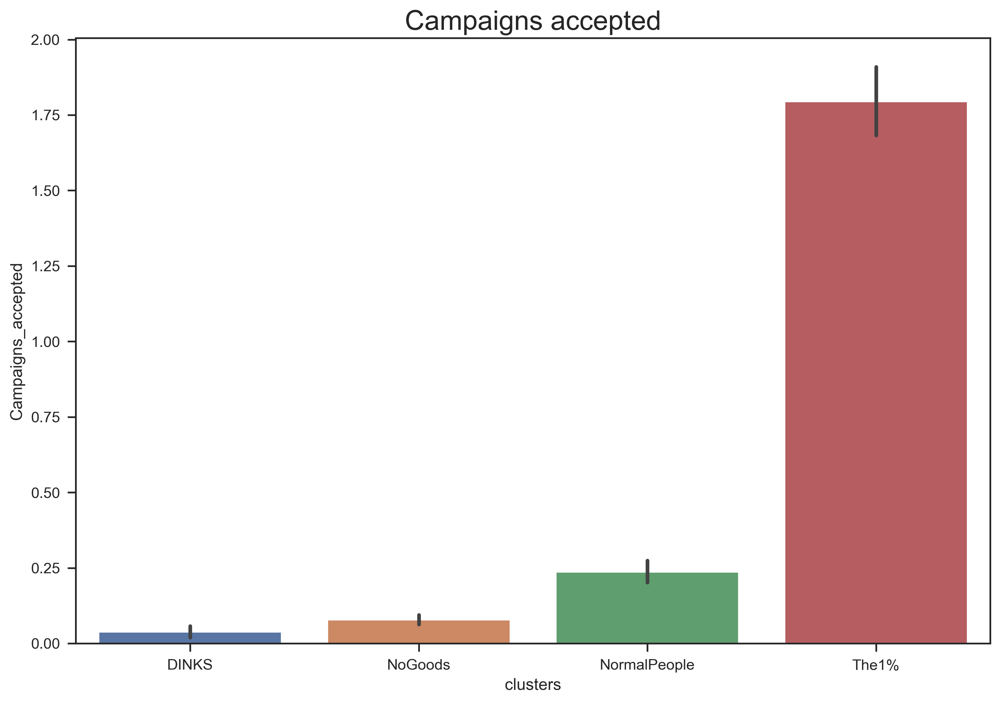

In [481]:
plt.figure(figsize=(12,8), dpi=300)
sns.barplot(data=df, x='clusters', y='Campaigns_accepted')
plt.title(label='Campaigns accepted', fontsize=20)
plt.savefig(transparent=True, fname='Campaigns_accepted')

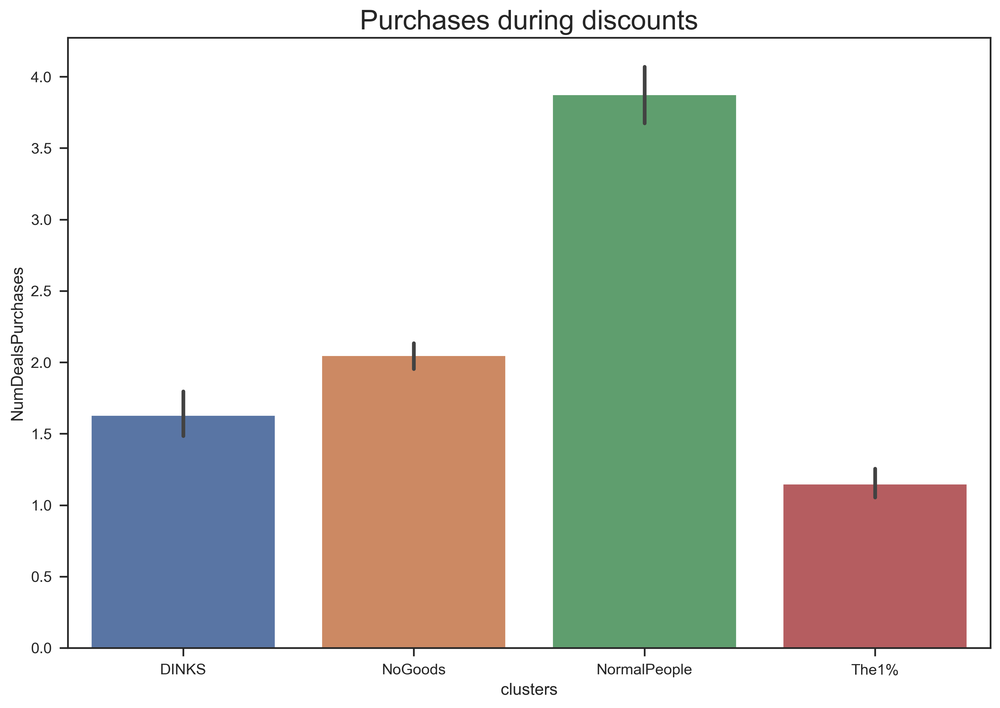

In [482]:
plt.figure(figsize=(12,8), dpi=300)
sns.barplot(data=df, x='clusters', y='NumDealsPurchases')
plt.title(label='Purchases during discounts', fontsize=20)
plt.savefig(transparent=True, fname='NumDealsPurchases')

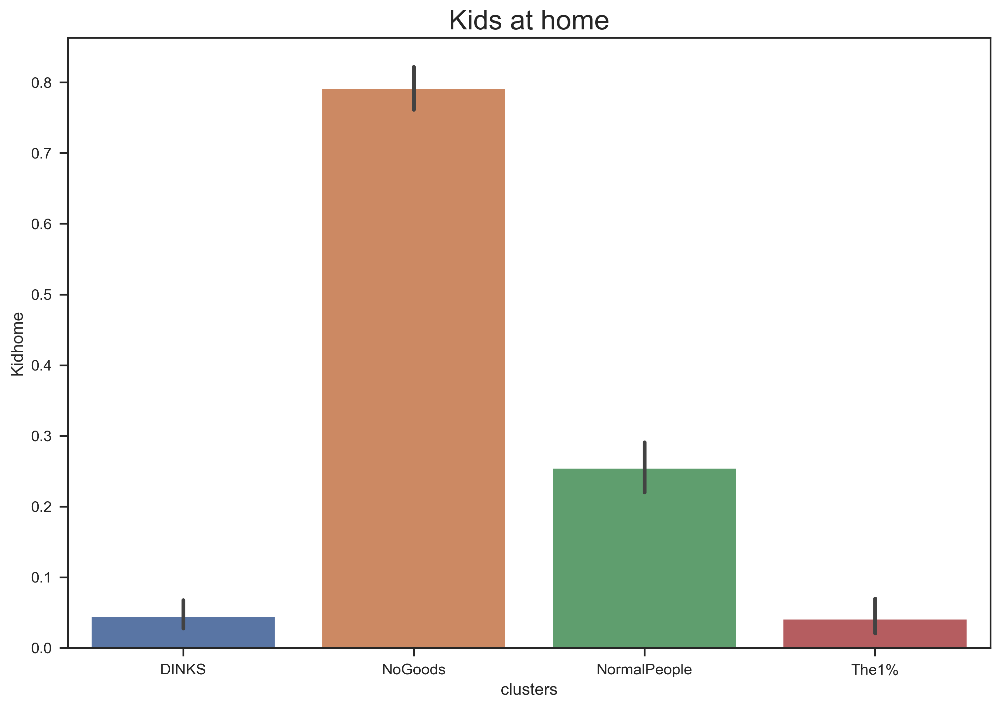

In [484]:
plt.figure(figsize=(12,8), dpi=300)
sns.barplot(data=df, x='clusters', y='Kidhome')
plt.title(label='Kids at home', fontsize=20)
plt.savefig(transparent=True, fname='Kidhome')

In [327]:
df.columns

Index(['Education', 'Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines',
       'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response', 'Age', 'Customer_Since',
       'Total_Spending', 'Campaigns_accepted', 'Household_Size',
       'Has_Used_Campaign', 'clusters'],
      dtype='object')

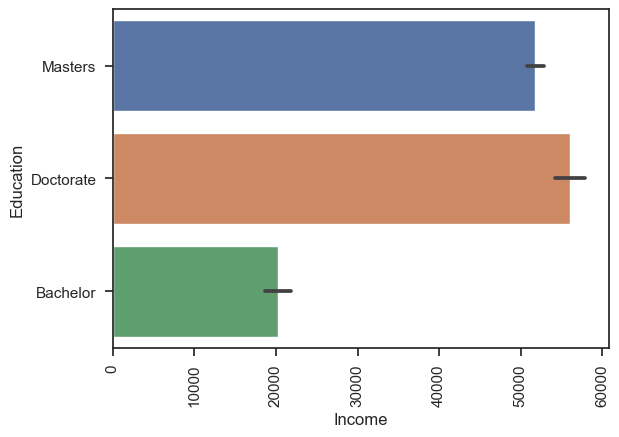

In [463]:
sns.barplot(data=df, x='Income', y='Education')
plt.xticks(rotation=90)
plt.show()

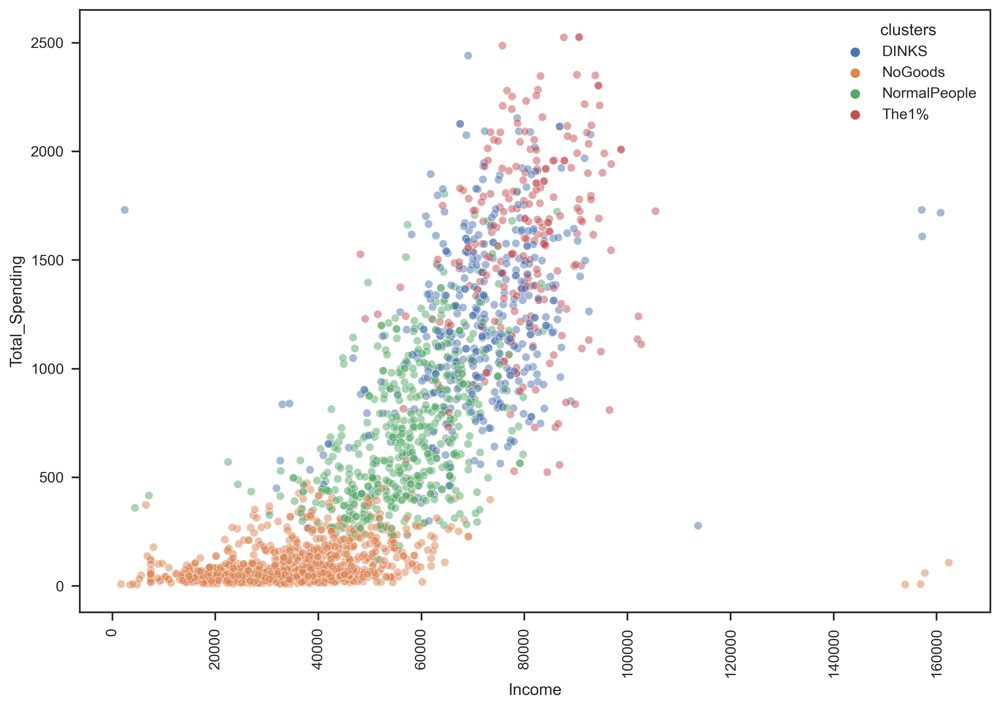

In [464]:
plt.figure(figsize=(12,8), dpi=300)
sns.scatterplot(data=df, x='Income', y='Total_Spending',hue='clusters',  alpha=0.5)
plt.xticks(rotation=90)
plt.show()

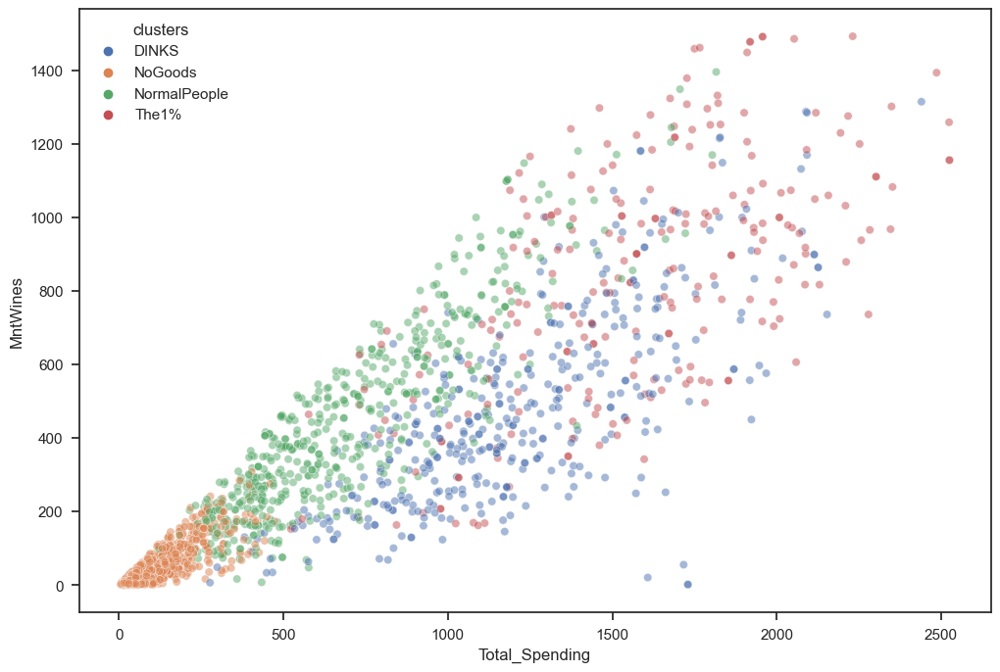

In [496]:
plt.figure(figsize=(12,8))
sns.despine()
sns.scatterplot(data=df, x='Total_Spending', y='MntWines',hue='clusters', alpha=0.5)

plt.show()

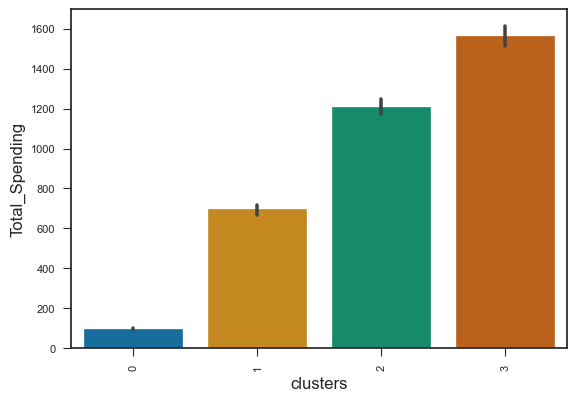

In [325]:
sns.barplot(data=df, x='clusters', y='Total_Spending')
plt.xticks(rotation=90)
plt.show()

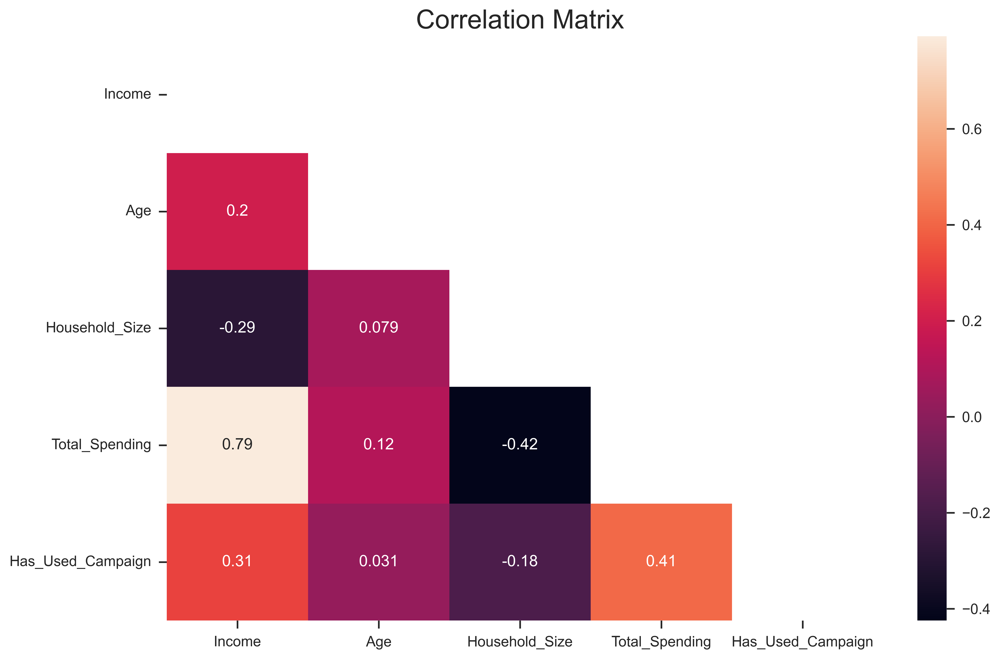

In [502]:
# Create correlation matrix
correlation_matrix = df[['Income', 'Age', 'Household_Size', 'Total_Spending', 'Has_Used_Campaign']].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# Plot the correlation matrix heatmap
plt.figure(figsize=(12, 8), dpi=500)
sns.heatmap(correlation_matrix, annot=True, mask=mask)
plt.title('Correlation Matrix', fontsize=20)
plt.savefig('CorrMatrix.png', transparent=True, dpi=500)
plt.show()

In [329]:
['Education', 'Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines',
       'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response', 'Age', 'Customer_Since',
       'Total_Spending', 'Campaigns_accepted', 'Household_Size',
       'Has_Used_Campaign', 'clusters']

['Education',
 'Income',
 'Kidhome',
 'Teenhome',
 'Recency',
 'MntWines',
 'MntFruits',
 'MntMeatProducts',
 'MntFishProducts',
 'MntSweetProducts',
 'MntGoldProds',
 'NumDealsPurchases',
 'NumWebPurchases',
 'NumCatalogPurchases',
 'NumStorePurchases',
 'NumWebVisitsMonth',
 'AcceptedCmp3',
 'AcceptedCmp4',
 'AcceptedCmp5',
 'AcceptedCmp1',
 'AcceptedCmp2',
 'Complain',
 'Response',
 'Age',
 'Customer_Since',
 'Total_Spending',
 'Campaigns_accepted',
 'Household_Size',
 'Has_Used_Campaign',
 'clusters']

In [335]:
df_subset_pairplot = df.loc[:, ['Education', 'Income', 'Recency',
                                'MntWines', 'MntFruits', 'MntMeatProducts',
                                'MntFishProducts', 'MntSweetProducts',
                                'MntGoldProds', 'NumDealsPurchases',
                                'NumWebPurchases', 'NumCatalogPurchases',
                                'NumStorePurchases', 'NumWebVisitsMonth',
                                'Age', 'Customer_Since', 'Total_Spending',
                                'Campaigns_accepted', 'Household_Size', 'clusters']]


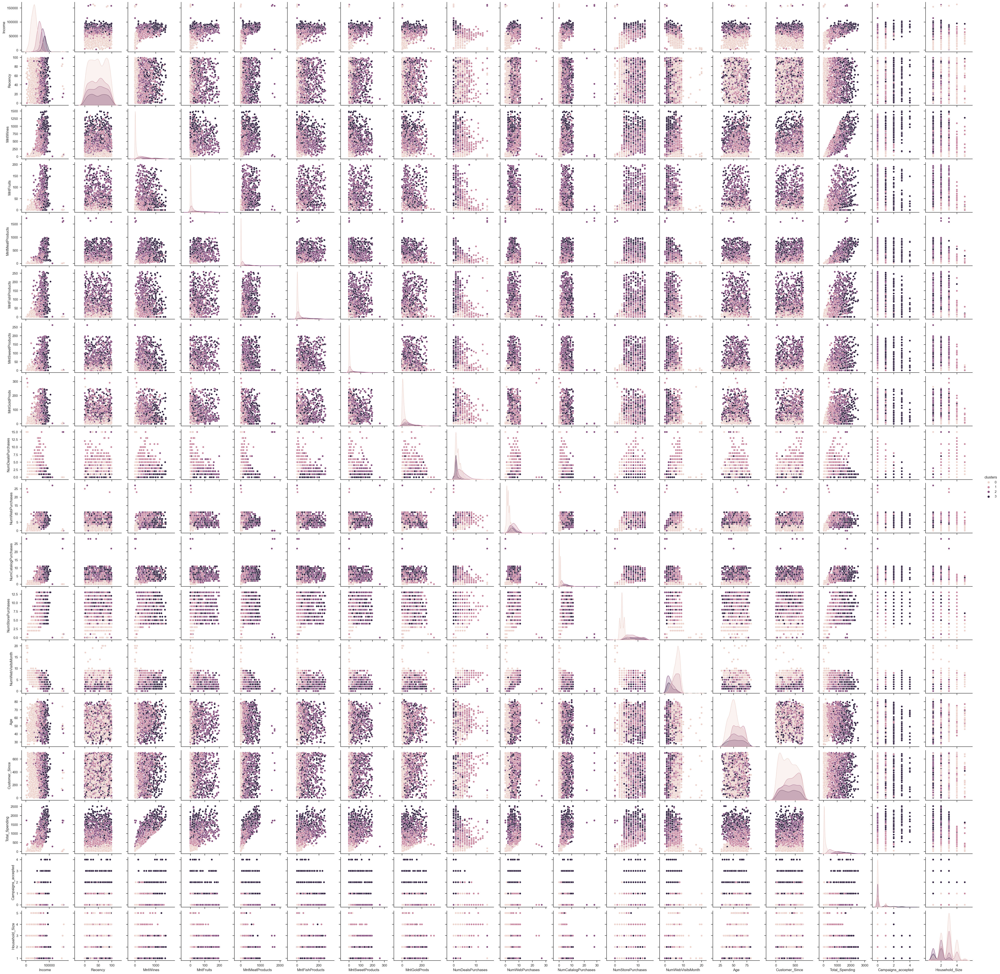

In [337]:
sns.set_theme(style="ticks")

sns.pairplot(data=df_subset_pairplot, hue='clusters')

plt.show()

In [ ]:
np.array(df).reshape()